In [35]:
%load_ext autoreload
%autoreload 2
%matplotlib inline

The autoreload extension is already loaded. To reload it, use:
  %reload_ext autoreload


In [36]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt

import os

from tensorflow.keras.preprocessing.image import load_img, img_to_array, array_to_img
from tensorflow.keras.models import load_model
from tensorflow.keras import Model
from tensorflow.keras import Input
from tensorflow.keras.preprocessing import image_dataset_from_directory
from sklearn.metrics.pairwise import linear_kernel,cosine_similarity
from scipy.sparse import csr_matrix

from tqdm.auto import tqdm

import time

In [37]:
i = pd.read_csv("../datasets/articles_transactions_5.csv")
t = pd.read_csv("../datasets/transactions_5.csv")

In [38]:
t.shape

(788257, 7)

In [39]:
i.shape

(26722, 26)

In [40]:
def load_image(path):
    tar_image = load_img(path,target_size=(28, 28), color_mode ='grayscale') # trousers
    img_array = img_to_array(tar_image) # Image Tensor
    img_array = np.array([img_array]) 
#   plt.figure()
#   plt.imshow(tar_image)
    return img_array

In [41]:
def show_image(item_id):
    cls = i['product_type_name'][i['article_id'] == item_id].values[0]
    path = f'../datasets/images/{cls.replace("/","")}/0{item_id}.jpg'
    if os.path.exists(path):
        tar_image = load_img(path,target_size=(224, 224)) 
        plt.figure()
        plt.imshow(tar_image)
    return

In [42]:
fashion_classifier = load_model("../Weights/cnn3_new.h5")

In [43]:
fashion_classifier.summary()


Model: "model_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_2 (InputLayer)        [(None, 28, 28, 1)]       0         
                                                                 
 rescaling_1 (Rescaling)     (None, 28, 28, 1)         0         
                                                                 
 model (Functional)          (None, 10)                241546    
                                                                 
 flatten_1 (Flatten)         (None, 10)                0         
                                                                 
 dense_2 (Dense)             (None, 1024)              11264     
                                                                 
 dropout_4 (Dropout)         (None, 1024)              0         
                                                                 
 dense_3 (Dense)             (None, 130)               1332

In [44]:
def get_cnn_activations(image_path):
    target_layer = "dense_2"
    tar_image = load_image(image_path)
    fashion_classifier.predict(tar_image)
    out = fashion_classifier.get_layer(target_layer).output
    activation_model = Model(fashion_classifier.input, out)
    activations = activation_model.predict(tar_image)
    #len(activations[0])
    return activations[0]

In [45]:
# image_dataset = image_dataset_from_directory(directory='../datasets/images', label_mode="categorical",color_mode ='grayscale', image_size=(28,28))

<a href='https://www.analyticsvidhya.com/blog/2022/07/recommending-similar-images-using-image-embedding/'> Article for this method </a>

In [46]:
# for dirc in tqdm(os.listdir('../datasets/images/')):
    
#     for img in os.listdir(f"../datasets/images/{dirc}/"):
       
#         cnn_emb_df['image_name'] = img
#         embed = pd.DataFrame(get_cnn_activations(f"../datasets/images/{dirc}/{img}"))
#         pd.concat([cnn_emb_df,embed])
# cnn_emb_df.to_csv('../datasets/cnn_embeddings.csv')
        

In [47]:
# only 26000 dealing with images 
# Getting the activations of all the 260000 images
cnn_emb_df = pd.DataFrame()
pd.set_option("display.max_rows", None)
count = 0
try:
    for img in tqdm(i['article_id'].drop_duplicates().values):
        
        cls = i['product_type_name'][i['article_id'] == img].values[0]
        if os.path.exists(f'../datasets/images/{cls.replace("/","")}/0{img}.jpg'):
            emb = get_cnn_activations(f'../datasets/images/{cls.replace("/","")}/0{img}.jpg')
            temp = pd.DataFrame(emb).T
            temp['image'] = img     
            cnn_emb_df = pd.concat([cnn_emb_df,temp],ignore_index=True)
            cnn_emb_df
            break
#             count+=1
#         if count == 4:
#             break # adding Break so if someone runs FUll jupyter it wont effect anything
#     cnn_emb_df
#     cnn_emb_df.to_csv('../datasets/col_cnn_embeddings.csv')


    print('Successfull')
except Exception as e:
    print(e)
# cnn_emb_df

  0%|          | 0/26722 [00:00<?, ?it/s]

1/1 [==============================] - 0s 61ms/step
Successfull


In [48]:
embeddings_df = pd.read_csv('../Datasets/col_cnn_embeddings.csv')

In [49]:
embeddings_df.shape

(25374, 1026)

In [50]:
embeddings_df.head(10240)

,Unnamed: 0,0,1,2,3,4,5,6,7,8,...,1015,1016,1017,1018,1019,1020,1021,1022,1023,image
0,0,0.049087,0.0,0.030510,0.000000,5.933424e-02,0.000000,0.0,0.025057,0.138850,...,0.003049,0.011435,0.0,0.000000,0.126702,0.134425,0.000000,0.069312,0.111229,775310002
1,1,0.000000,0.0,0.037686,0.000000,6.781805e-02,0.064060,0.0,0.000000,0.000000,...,0.086035,0.000000,0.0,0.148402,0.067697,0.042614,0.000000,0.000000,0.010147,872813003
2,2,0.000000,0.0,0.031263,0.000000,7.051123e-02,0.065301,0.0,0.000000,0.000000,...,0.083533,0.000000,0.0,0.133070,0.069236,0.046167,0.000000,0.000000,0.015295,872813001
3,3,0.021971,0.0,0.032965,0.000000,4.485123e-02,0.035633,0.0,0.000000,0.075174,...,0.022164,0.000000,0.0,0.000546,0.103162,0.059424,0.000000,0.019324,0.069340,860411004
4,4,0.000000,0.0,0.066148,0.000000,4.568420e-02,0.000000,0.0,0.041443,0.122582,...,0.046436,0.000000,0.0,0.000000,0.102105,0.114178,0.000000,0.000000,0.101119,883068004
5,5,0.005006,0.0,0.030079,0.000000,6.540348e-02,0.070500,0.0,0.000000,0.002131,...,0.077954,0.000000,0.0,0.119717,0.069923,0.039694,0.000000,0.000000,0.020130,866755001
6,6,0.000000,0.0,0.178052,0.000000,0.000000e+00,0.194402,0.0,0.000000,0.094213,...,0.071223,0.000000,0.0,0.199016,0.000000,0.000000,0.000000,0.000000,0.012902,399256002
7,7,0.000000,0.0,0.073244,0.000000,9.485602e-03,0.032237,0.0,0.009363,0.123628,...,0.033791,0.000000,0.0,0.000000,0.088291,0.058222,0.000000,0.000000,0.087588,873428004
8,8,0.000000,0.0,0.079281,0.000000,1.798546e-02,0.019293,0.0,0.024903,0.125762,...,0.045649,0.000000,0.0,0.000000,0.088570,0.076288,0.000000,0.000000,0.093231,873428001
9,9,0.000000,0.0,0.062098,0.000000,5.504129e-02,0.000000,0.0,0.051582,0.141500,...,0.041916,0.001014,0.0,0.000000,0.110011,0.141136,0.000000,0.017717,0.116051,883068001


In [51]:
embeddings_df[embeddings_df['image']== 883068001].values

array([[9.00000000e+00, 0.00000000e+00, 0.00000000e+00, ...,
        1.77174140e-02, 1.16051000e-01, 8.83068001e+08]])

In [52]:
len(embeddings_df[embeddings_df['image']== 883068001].values[0])

1026

In [53]:
cosine = cosine_similarity(embeddings_df.drop('image',axis=1))
images = embeddings_df['image'].values
cosine_df = pd.DataFrame(cosine, columns=images, index=images)
cosine_df.head(25)

,775310002,872813003,872813001,860411004,883068004,866755001,399256002,873428004,873428001,883068001,...,806261002,893215001,697050011,783802002,899222001,570900005,712216011,816995001,682854005,805505001
775310002,1.000000,0.561984,0.454619,0.492921,0.491716,0.236495,0.152234,0.261877,0.245796,0.272522,...,0.000058,0.000072,0.000058,0.000044,0.000084,0.000043,0.000093,0.000054,0.000082,0.000065
872813003,0.561984,1.000000,0.944661,0.790820,0.722532,0.741748,0.690243,0.639194,0.623160,0.603402,...,0.457105,0.457113,0.457106,0.457128,0.457102,0.457117,0.457101,0.457110,0.457103,0.457103
872813001,0.454619,0.944661,1.000000,0.929606,0.878210,0.919415,0.853634,0.847321,0.836406,0.821237,...,0.718954,0.718959,0.718954,0.718971,0.718952,0.718962,0.718952,0.718957,0.718953,0.718952
860411004,0.492921,0.790820,0.929606,1.000000,0.978373,0.954371,0.883435,0.953942,0.945616,0.941945,...,0.839326,0.839329,0.839326,0.839323,0.839332,0.839321,0.839335,0.839324,0.839332,0.839328
883068004,0.491716,0.722532,0.878210,0.978373,1.000000,0.935744,0.873853,0.965164,0.962396,0.966278,...,0.858353,0.858361,0.858353,0.858345,0.858362,0.858347,0.858363,0.858351,0.858362,0.858357
866755001,0.236495,0.741748,0.919415,0.954371,0.935744,1.000000,0.942030,0.976309,0.973725,0.963978,...,0.933764,0.933765,0.933764,0.933772,0.933763,0.933767,0.933763,0.933765,0.933763,0.933763
399256002,0.152234,0.690243,0.853634,0.883435,0.873853,0.942030,1.000000,0.933833,0.928990,0.904753,...,0.889589,0.889578,0.889586,0.889588,0.889575,0.889588,0.889574,0.889582,0.889580,0.889589
873428004,0.261877,0.639194,0.847321,0.953942,0.965164,0.976309,0.933833,1.000000,0.999304,0.994428,...,0.956664,0.956665,0.956664,0.956659,0.956666,0.956660,0.956666,0.956661,0.956667,0.956666
873428001,0.245796,0.623160,0.836406,0.945616,0.962396,0.973725,0.928990,0.999304,1.000000,0.996691,...,0.963061,0.963062,0.963060,0.963056,0.963063,0.963057,0.963063,0.963058,0.963064,0.963063
883068001,0.272522,0.603402,0.821237,0.941945,0.966278,0.963978,0.904753,0.994428,0.996691,1.000000,...,0.960348,0.960353,0.960348,0.960344,0.960354,0.960344,0.960355,0.960347,0.960354,0.960350


In [54]:
def cnn_recommender(customer):
    all_similar_items = pd.DataFrame()
    customer_purchases = t['article_id'][t['customer_id'] == customer].drop_duplicates().values
    for item in customer_purchases:
        cls = i['product_type_name'][i['article_id'] == item].values[0]
        if os.path.exists(f'../datasets/images/{cls.replace("/","")}/0{item}.jpg'):
            similar_imgs = cosine_df[item].sort_values(ascending=False)
                  
            all_similar_items = pd.concat([all_similar_items,similar_imgs.nlargest(6)])[1:]
    return list(set(all_similar_items[0].nlargest(6).index.values))

In [55]:
pd.set_option("display.max_rows", None)

In [56]:
user_purchases = t[t['customer_id']=='65cb62c794232651e2ac711faa11c2b4e3d41d5f3b59b50bee3ffde1d5776644']['article_id'].drop_duplicates().values
    

In [57]:
print(cnn_recommender('65cb62c794232651e2ac711faa11c2b4e3d41d5f3b59b50bee3ffde1d5776644'))

[859076001, 881544005, 859081002, 854222002, 839402002, 763842008]


<h2>Purchases</h2>

C:\Users\Hammozi\AppData\Local\Temp\ipykernel_30668\1423851039.py:6: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  plt.figure()


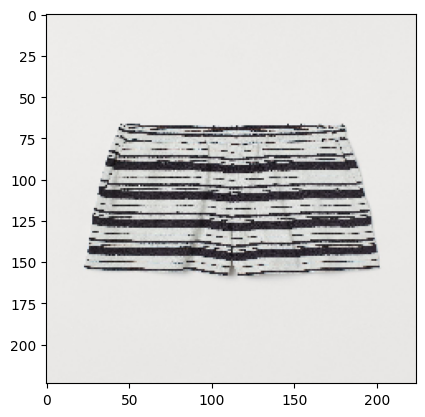

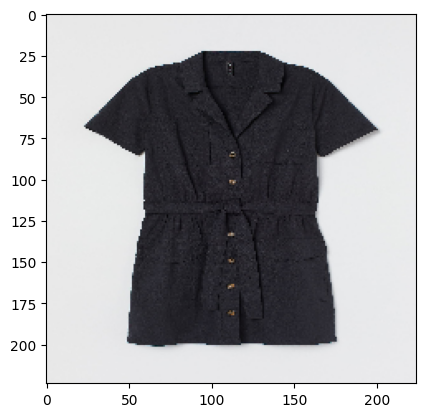

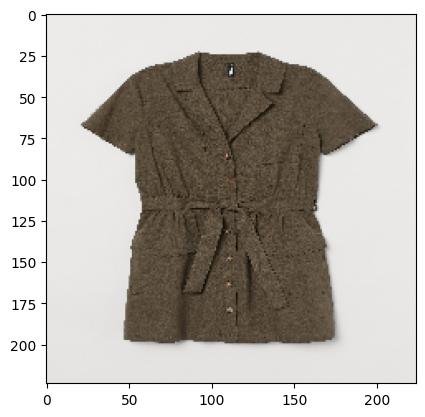

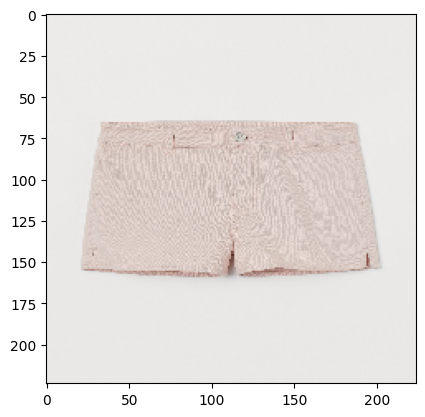

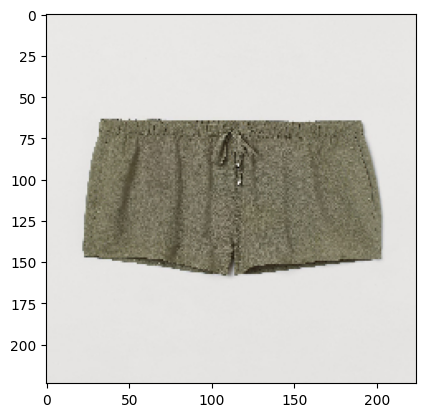

...

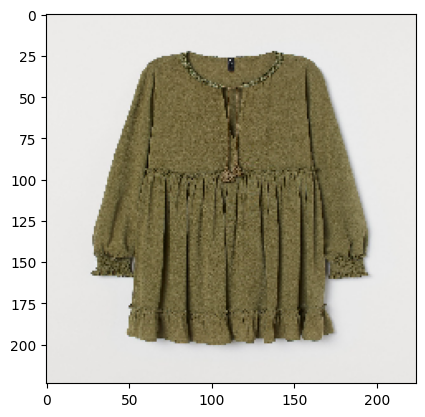

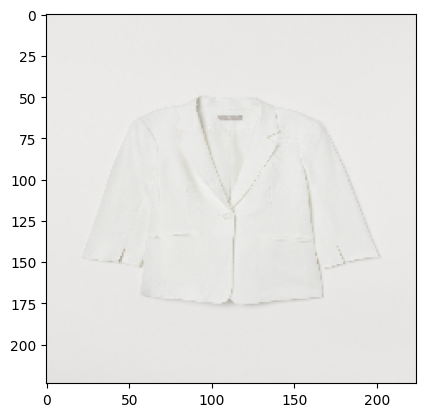

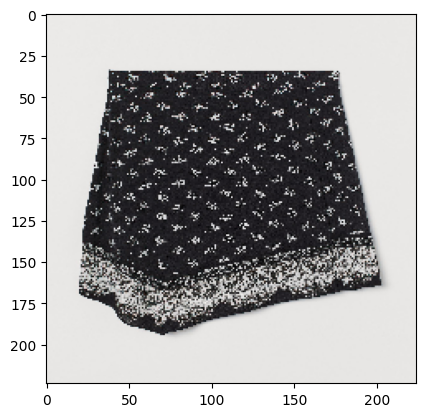

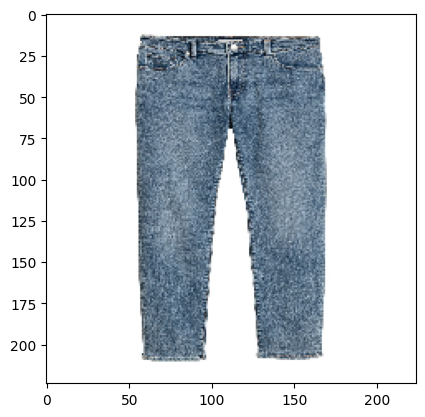

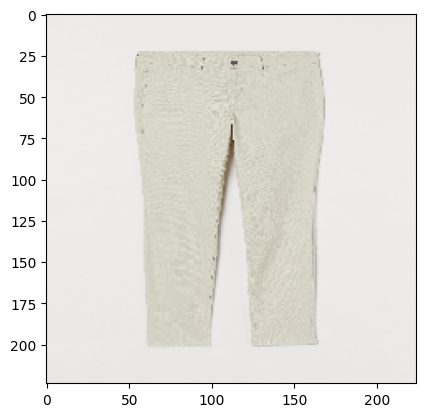

In [58]:
for p in user_purchases:
    show_image(p)

<h2>Recommended Items</h2>

In [59]:
rec_items = cnn_recommender('65cb62c794232651e2ac711faa11c2b4e3d41d5f3b59b50bee3ffde1d5776644')

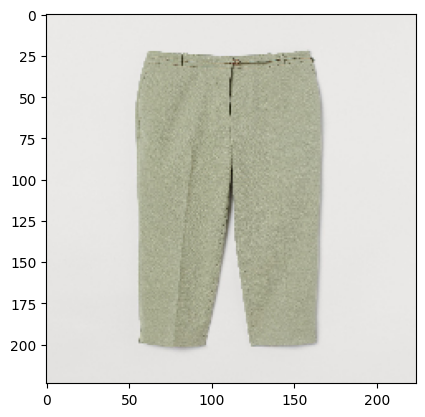

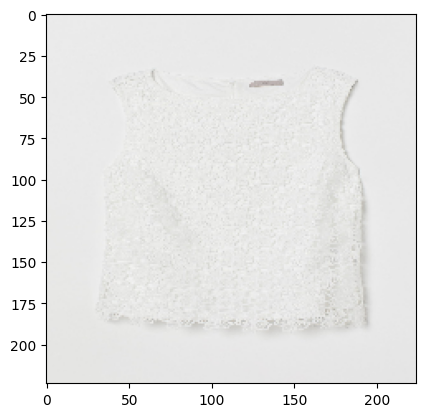

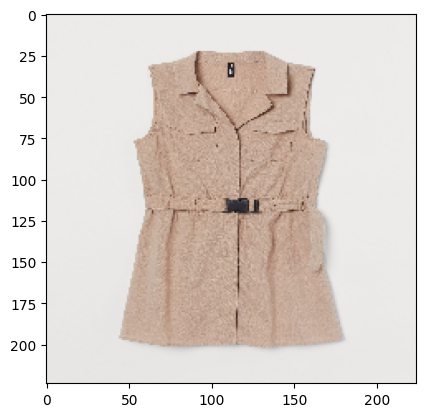

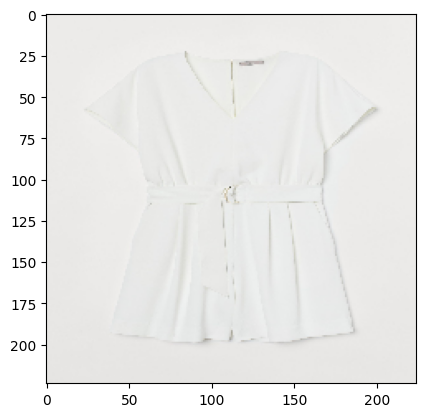

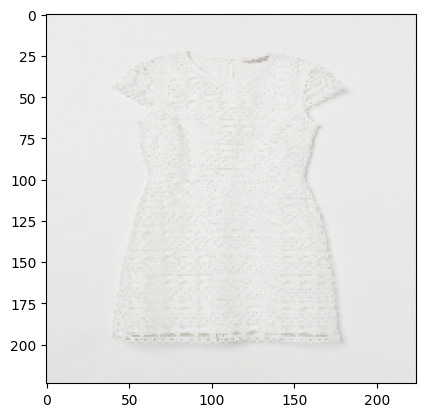

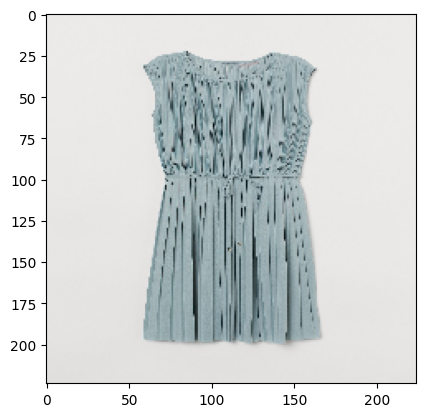

In [60]:
for ri in rec_items:
    show_image(ri)

In [61]:
t.shape

(788257, 7)

In [62]:
transac = t

In [63]:
transac.shape

(788257, 7)

In [64]:
u = t['customer_id'].drop_duplicates().to_frame()

In [65]:
u.shape

(84234, 1)

In [66]:
test_u = u.sample(n=1000, random_state = 1)
test_t = pd.DataFrame()
for k,cust in tqdm(enumerate(test_u['customer_id'])):  
    cust_transac = transac[transac['customer_id'] == cust]
    bottom_transac = cust_transac[-1 * round(0.20 * len(cust_transac)):]
    test_t = test_t.append(bottom_transac)
    indexs = bottom_transac.index
    transac.drop(labels = indexs, axis = 0,inplace=True )
#     print(k)
test_t.shape
test_t.head()

0it [00:00, ?it/s]

C:\Users\Hammozi\AppData\Local\Temp\ipykernel_30668\1811027151.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  test_t = test_t.append(bottom_transac)
C:\Users\Hammozi\AppData\Local\Temp\ipykernel_30668\1811027151.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  test_t = test_t.append(bottom_transac)
C:\Users\Hammozi\AppData\Local\Temp\ipykernel_30668\1811027151.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  test_t = test_t.append(bottom_transac)
C:\Users\Hammozi\AppData\Local\Temp\ipykernel_30668\1811027151.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  test_t = test_t.append(bottom_transac)
C:\Users\Hammozi\AppData\Loc

C:\Users\Hammozi\AppData\Local\Temp\ipykernel_30668\1811027151.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  test_t = test_t.append(bottom_transac)
C:\Users\Hammozi\AppData\Local\Temp\ipykernel_30668\1811027151.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  test_t = test_t.append(bottom_transac)
C:\Users\Hammozi\AppData\Local\Temp\ipykernel_30668\1811027151.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  test_t = test_t.append(bottom_transac)
C:\Users\Hammozi\AppData\Local\Temp\ipykernel_30668\1811027151.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  test_t = test_t.append(bottom_transac)
C:\Users\Hammozi\AppData\Loc

C:\Users\Hammozi\AppData\Local\Temp\ipykernel_30668\1811027151.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  test_t = test_t.append(bottom_transac)
C:\Users\Hammozi\AppData\Local\Temp\ipykernel_30668\1811027151.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  test_t = test_t.append(bottom_transac)
C:\Users\Hammozi\AppData\Local\Temp\ipykernel_30668\1811027151.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  test_t = test_t.append(bottom_transac)
C:\Users\Hammozi\AppData\Local\Temp\ipykernel_30668\1811027151.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  test_t = test_t.append(bottom_transac)
C:\Users\Hammozi\AppData\Loc

C:\Users\Hammozi\AppData\Local\Temp\ipykernel_30668\1811027151.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  test_t = test_t.append(bottom_transac)
C:\Users\Hammozi\AppData\Local\Temp\ipykernel_30668\1811027151.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  test_t = test_t.append(bottom_transac)
C:\Users\Hammozi\AppData\Local\Temp\ipykernel_30668\1811027151.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  test_t = test_t.append(bottom_transac)
C:\Users\Hammozi\AppData\Local\Temp\ipykernel_30668\1811027151.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  test_t = test_t.append(bottom_transac)
C:\Users\Hammozi\AppData\Loc

C:\Users\Hammozi\AppData\Local\Temp\ipykernel_30668\1811027151.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  test_t = test_t.append(bottom_transac)
C:\Users\Hammozi\AppData\Local\Temp\ipykernel_30668\1811027151.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  test_t = test_t.append(bottom_transac)
C:\Users\Hammozi\AppData\Local\Temp\ipykernel_30668\1811027151.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  test_t = test_t.append(bottom_transac)
C:\Users\Hammozi\AppData\Local\Temp\ipykernel_30668\1811027151.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  test_t = test_t.append(bottom_transac)
C:\Users\Hammozi\AppData\Loc

C:\Users\Hammozi\AppData\Local\Temp\ipykernel_30668\1811027151.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  test_t = test_t.append(bottom_transac)
C:\Users\Hammozi\AppData\Local\Temp\ipykernel_30668\1811027151.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  test_t = test_t.append(bottom_transac)
C:\Users\Hammozi\AppData\Local\Temp\ipykernel_30668\1811027151.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  test_t = test_t.append(bottom_transac)
C:\Users\Hammozi\AppData\Local\Temp\ipykernel_30668\1811027151.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  test_t = test_t.append(bottom_transac)
C:\Users\Hammozi\AppData\Loc

C:\Users\Hammozi\AppData\Local\Temp\ipykernel_30668\1811027151.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  test_t = test_t.append(bottom_transac)
C:\Users\Hammozi\AppData\Local\Temp\ipykernel_30668\1811027151.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  test_t = test_t.append(bottom_transac)
C:\Users\Hammozi\AppData\Local\Temp\ipykernel_30668\1811027151.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  test_t = test_t.append(bottom_transac)
C:\Users\Hammozi\AppData\Local\Temp\ipykernel_30668\1811027151.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  test_t = test_t.append(bottom_transac)
C:\Users\Hammozi\AppData\Loc

C:\Users\Hammozi\AppData\Local\Temp\ipykernel_30668\1811027151.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  test_t = test_t.append(bottom_transac)
C:\Users\Hammozi\AppData\Local\Temp\ipykernel_30668\1811027151.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  test_t = test_t.append(bottom_transac)
C:\Users\Hammozi\AppData\Local\Temp\ipykernel_30668\1811027151.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  test_t = test_t.append(bottom_transac)
C:\Users\Hammozi\AppData\Local\Temp\ipykernel_30668\1811027151.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  test_t = test_t.append(bottom_transac)
C:\Users\Hammozi\AppData\Loc

C:\Users\Hammozi\AppData\Local\Temp\ipykernel_30668\1811027151.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  test_t = test_t.append(bottom_transac)
C:\Users\Hammozi\AppData\Local\Temp\ipykernel_30668\1811027151.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  test_t = test_t.append(bottom_transac)
C:\Users\Hammozi\AppData\Local\Temp\ipykernel_30668\1811027151.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  test_t = test_t.append(bottom_transac)
C:\Users\Hammozi\AppData\Local\Temp\ipykernel_30668\1811027151.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  test_t = test_t.append(bottom_transac)
C:\Users\Hammozi\AppData\Loc

C:\Users\Hammozi\AppData\Local\Temp\ipykernel_30668\1811027151.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  test_t = test_t.append(bottom_transac)
C:\Users\Hammozi\AppData\Local\Temp\ipykernel_30668\1811027151.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  test_t = test_t.append(bottom_transac)
C:\Users\Hammozi\AppData\Local\Temp\ipykernel_30668\1811027151.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  test_t = test_t.append(bottom_transac)
C:\Users\Hammozi\AppData\Local\Temp\ipykernel_30668\1811027151.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  test_t = test_t.append(bottom_transac)
C:\Users\Hammozi\AppData\Loc

C:\Users\Hammozi\AppData\Local\Temp\ipykernel_30668\1811027151.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  test_t = test_t.append(bottom_transac)
C:\Users\Hammozi\AppData\Local\Temp\ipykernel_30668\1811027151.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  test_t = test_t.append(bottom_transac)
C:\Users\Hammozi\AppData\Local\Temp\ipykernel_30668\1811027151.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  test_t = test_t.append(bottom_transac)
C:\Users\Hammozi\AppData\Local\Temp\ipykernel_30668\1811027151.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  test_t = test_t.append(bottom_transac)
C:\Users\Hammozi\AppData\Loc

C:\Users\Hammozi\AppData\Local\Temp\ipykernel_30668\1811027151.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  test_t = test_t.append(bottom_transac)
C:\Users\Hammozi\AppData\Local\Temp\ipykernel_30668\1811027151.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  test_t = test_t.append(bottom_transac)
C:\Users\Hammozi\AppData\Local\Temp\ipykernel_30668\1811027151.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  test_t = test_t.append(bottom_transac)
C:\Users\Hammozi\AppData\Local\Temp\ipykernel_30668\1811027151.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  test_t = test_t.append(bottom_transac)
C:\Users\Hammozi\AppData\Loc

C:\Users\Hammozi\AppData\Local\Temp\ipykernel_30668\1811027151.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  test_t = test_t.append(bottom_transac)
C:\Users\Hammozi\AppData\Local\Temp\ipykernel_30668\1811027151.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  test_t = test_t.append(bottom_transac)
C:\Users\Hammozi\AppData\Local\Temp\ipykernel_30668\1811027151.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  test_t = test_t.append(bottom_transac)
C:\Users\Hammozi\AppData\Local\Temp\ipykernel_30668\1811027151.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  test_t = test_t.append(bottom_transac)
C:\Users\Hammozi\AppData\Loc

C:\Users\Hammozi\AppData\Local\Temp\ipykernel_30668\1811027151.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  test_t = test_t.append(bottom_transac)
C:\Users\Hammozi\AppData\Local\Temp\ipykernel_30668\1811027151.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  test_t = test_t.append(bottom_transac)
C:\Users\Hammozi\AppData\Local\Temp\ipykernel_30668\1811027151.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  test_t = test_t.append(bottom_transac)
C:\Users\Hammozi\AppData\Local\Temp\ipykernel_30668\1811027151.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  test_t = test_t.append(bottom_transac)
C:\Users\Hammozi\AppData\Loc

C:\Users\Hammozi\AppData\Local\Temp\ipykernel_30668\1811027151.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  test_t = test_t.append(bottom_transac)
C:\Users\Hammozi\AppData\Local\Temp\ipykernel_30668\1811027151.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  test_t = test_t.append(bottom_transac)
C:\Users\Hammozi\AppData\Local\Temp\ipykernel_30668\1811027151.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  test_t = test_t.append(bottom_transac)
C:\Users\Hammozi\AppData\Local\Temp\ipykernel_30668\1811027151.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  test_t = test_t.append(bottom_transac)
C:\Users\Hammozi\AppData\Loc

C:\Users\Hammozi\AppData\Local\Temp\ipykernel_30668\1811027151.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  test_t = test_t.append(bottom_transac)
C:\Users\Hammozi\AppData\Local\Temp\ipykernel_30668\1811027151.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  test_t = test_t.append(bottom_transac)
C:\Users\Hammozi\AppData\Local\Temp\ipykernel_30668\1811027151.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  test_t = test_t.append(bottom_transac)
C:\Users\Hammozi\AppData\Local\Temp\ipykernel_30668\1811027151.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  test_t = test_t.append(bottom_transac)
C:\Users\Hammozi\AppData\Loc

C:\Users\Hammozi\AppData\Local\Temp\ipykernel_30668\1811027151.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  test_t = test_t.append(bottom_transac)
C:\Users\Hammozi\AppData\Local\Temp\ipykernel_30668\1811027151.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  test_t = test_t.append(bottom_transac)
C:\Users\Hammozi\AppData\Local\Temp\ipykernel_30668\1811027151.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  test_t = test_t.append(bottom_transac)
C:\Users\Hammozi\AppData\Local\Temp\ipykernel_30668\1811027151.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  test_t = test_t.append(bottom_transac)
C:\Users\Hammozi\AppData\Loc

C:\Users\Hammozi\AppData\Local\Temp\ipykernel_30668\1811027151.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  test_t = test_t.append(bottom_transac)
C:\Users\Hammozi\AppData\Local\Temp\ipykernel_30668\1811027151.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  test_t = test_t.append(bottom_transac)
C:\Users\Hammozi\AppData\Local\Temp\ipykernel_30668\1811027151.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  test_t = test_t.append(bottom_transac)
C:\Users\Hammozi\AppData\Local\Temp\ipykernel_30668\1811027151.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  test_t = test_t.append(bottom_transac)
C:\Users\Hammozi\AppData\Loc

C:\Users\Hammozi\AppData\Local\Temp\ipykernel_30668\1811027151.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  test_t = test_t.append(bottom_transac)
C:\Users\Hammozi\AppData\Local\Temp\ipykernel_30668\1811027151.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  test_t = test_t.append(bottom_transac)
C:\Users\Hammozi\AppData\Local\Temp\ipykernel_30668\1811027151.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  test_t = test_t.append(bottom_transac)
C:\Users\Hammozi\AppData\Local\Temp\ipykernel_30668\1811027151.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  test_t = test_t.append(bottom_transac)
C:\Users\Hammozi\AppData\Loc

C:\Users\Hammozi\AppData\Local\Temp\ipykernel_30668\1811027151.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  test_t = test_t.append(bottom_transac)
C:\Users\Hammozi\AppData\Local\Temp\ipykernel_30668\1811027151.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  test_t = test_t.append(bottom_transac)
C:\Users\Hammozi\AppData\Local\Temp\ipykernel_30668\1811027151.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  test_t = test_t.append(bottom_transac)
C:\Users\Hammozi\AppData\Local\Temp\ipykernel_30668\1811027151.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  test_t = test_t.append(bottom_transac)
C:\Users\Hammozi\AppData\Loc

C:\Users\Hammozi\AppData\Local\Temp\ipykernel_30668\1811027151.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  test_t = test_t.append(bottom_transac)
C:\Users\Hammozi\AppData\Local\Temp\ipykernel_30668\1811027151.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  test_t = test_t.append(bottom_transac)
C:\Users\Hammozi\AppData\Local\Temp\ipykernel_30668\1811027151.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  test_t = test_t.append(bottom_transac)
C:\Users\Hammozi\AppData\Local\Temp\ipykernel_30668\1811027151.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  test_t = test_t.append(bottom_transac)
C:\Users\Hammozi\AppData\Loc

C:\Users\Hammozi\AppData\Local\Temp\ipykernel_30668\1811027151.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  test_t = test_t.append(bottom_transac)
C:\Users\Hammozi\AppData\Local\Temp\ipykernel_30668\1811027151.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  test_t = test_t.append(bottom_transac)
C:\Users\Hammozi\AppData\Local\Temp\ipykernel_30668\1811027151.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  test_t = test_t.append(bottom_transac)
C:\Users\Hammozi\AppData\Local\Temp\ipykernel_30668\1811027151.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  test_t = test_t.append(bottom_transac)
C:\Users\Hammozi\AppData\Loc

C:\Users\Hammozi\AppData\Local\Temp\ipykernel_30668\1811027151.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  test_t = test_t.append(bottom_transac)
C:\Users\Hammozi\AppData\Local\Temp\ipykernel_30668\1811027151.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  test_t = test_t.append(bottom_transac)
C:\Users\Hammozi\AppData\Local\Temp\ipykernel_30668\1811027151.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  test_t = test_t.append(bottom_transac)
C:\Users\Hammozi\AppData\Local\Temp\ipykernel_30668\1811027151.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  test_t = test_t.append(bottom_transac)
C:\Users\Hammozi\AppData\Loc

C:\Users\Hammozi\AppData\Local\Temp\ipykernel_30668\1811027151.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  test_t = test_t.append(bottom_transac)
C:\Users\Hammozi\AppData\Local\Temp\ipykernel_30668\1811027151.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  test_t = test_t.append(bottom_transac)
C:\Users\Hammozi\AppData\Local\Temp\ipykernel_30668\1811027151.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  test_t = test_t.append(bottom_transac)
C:\Users\Hammozi\AppData\Local\Temp\ipykernel_30668\1811027151.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  test_t = test_t.append(bottom_transac)
C:\Users\Hammozi\AppData\Loc

C:\Users\Hammozi\AppData\Local\Temp\ipykernel_30668\1811027151.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  test_t = test_t.append(bottom_transac)
C:\Users\Hammozi\AppData\Local\Temp\ipykernel_30668\1811027151.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  test_t = test_t.append(bottom_transac)
C:\Users\Hammozi\AppData\Local\Temp\ipykernel_30668\1811027151.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  test_t = test_t.append(bottom_transac)
C:\Users\Hammozi\AppData\Local\Temp\ipykernel_30668\1811027151.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  test_t = test_t.append(bottom_transac)
C:\Users\Hammozi\AppData\Loc

C:\Users\Hammozi\AppData\Local\Temp\ipykernel_30668\1811027151.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  test_t = test_t.append(bottom_transac)
C:\Users\Hammozi\AppData\Local\Temp\ipykernel_30668\1811027151.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  test_t = test_t.append(bottom_transac)
C:\Users\Hammozi\AppData\Local\Temp\ipykernel_30668\1811027151.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  test_t = test_t.append(bottom_transac)
C:\Users\Hammozi\AppData\Local\Temp\ipykernel_30668\1811027151.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  test_t = test_t.append(bottom_transac)
C:\Users\Hammozi\AppData\Loc

C:\Users\Hammozi\AppData\Local\Temp\ipykernel_30668\1811027151.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  test_t = test_t.append(bottom_transac)
C:\Users\Hammozi\AppData\Local\Temp\ipykernel_30668\1811027151.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  test_t = test_t.append(bottom_transac)
C:\Users\Hammozi\AppData\Local\Temp\ipykernel_30668\1811027151.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  test_t = test_t.append(bottom_transac)
C:\Users\Hammozi\AppData\Local\Temp\ipykernel_30668\1811027151.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  test_t = test_t.append(bottom_transac)
C:\Users\Hammozi\AppData\Loc

C:\Users\Hammozi\AppData\Local\Temp\ipykernel_30668\1811027151.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  test_t = test_t.append(bottom_transac)
C:\Users\Hammozi\AppData\Local\Temp\ipykernel_30668\1811027151.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  test_t = test_t.append(bottom_transac)
C:\Users\Hammozi\AppData\Local\Temp\ipykernel_30668\1811027151.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  test_t = test_t.append(bottom_transac)
C:\Users\Hammozi\AppData\Local\Temp\ipykernel_30668\1811027151.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  test_t = test_t.append(bottom_transac)
C:\Users\Hammozi\AppData\Loc

,Unnamed: 0.1,Unnamed: 0,t_dat,customer_id,article_id,price,sales_channel_id
117789,1679416,31474237,2020-09-13,8bbf433ee460776600b2750a3a24c911eff36fa25b0397...,762846006,0.022864,2
117790,1679417,31474238,2020-09-13,8bbf433ee460776600b2750a3a24c911eff36fa25b0397...,916866002,0.038119,2
117791,1679418,31474239,2020-09-13,8bbf433ee460776600b2750a3a24c911eff36fa25b0397...,865799006,0.030492,2
117792,1679419,31474240,2020-09-13,8bbf433ee460776600b2750a3a24c911eff36fa25b0397...,895610003,0.045746,2
511113,1207789,31002610,2020-09-01,559d63db9fc01fbf65b1d53fd3e59d8b6337b311fa3e9b...,910449004,0.033881,2


In [67]:
precision_list_cnn = []
print(test_u.shape)
for j,user in tqdm(enumerate(test_u['customer_id'])):
    cnn_rec = cnn_recommender(user)
    u_purchases = test_t[test_t['customer_id'] == user]['article_id'].values
    precision_list_cnn.append(len(np.intersect1d(cnn_rec,u_purchases))/5)
print("MEAN Precison of CNN based Recommender",sum(precision_list_cnn)/len(precision_list_cnn))
    

(1000, 1)


0it [00:00, ?it/s]

MEAN Precison of CNN based Recommender 0.038200000000000005
